In [1]:
import json
import os.path as op

from nimare.decode.continuous import CorrelationDecoder
import matplotlib.pyplot as plt
from gradec.utils import _decoding_filter
import pandas as pd
from nilearn.plotting import plot_stat_map, plot_img
from nimare.results import MetaResult
from gradec.plot import plot_radar, plot_cloud
from gradec.fetcher import _fetch_features, _fetch_frequencies, _fetch_classification
from nilearn import datasets
import matplotlib.image as mpimg
from matplotlib.gridspec import GridSpec

In [2]:
results_dir = '../results/ibma'
data_dir = '../data'
figures_dir = './'
decoding_dir = op.join(data_dir, 'decoding')
fig_dec_dir = op.join(figures_dir, "decoding")
data_types = ["raw", "clean"]
data_tp_lb = ["Unfiltered", "Filtered"]

In [3]:
cogat_df = pd.read_csv(op.join(data_dir, "cogat_terms.csv"))
task_names = cogat_df["cogat_nm"].tolist()
task_names.reverse()
n_tasks = len(task_names)

with open(op.join(data_dir, "cogat_terms.json"), 'r') as f:
    cogat_dict = json.load(f)

In [4]:
DSET, MODEL = "neuroquery", "lda"
decoder_fn = op.join(decoding_dir, f"{MODEL}_{DSET}_decoder.pkl.gz")
if not op.isfile(decoder_fn):
    dec_img_dir = op.join(decoding_dir, f"{MODEL}_{DSET}_decoder")
    mask_img = op.join(decoding_dir, f"{MODEL}_{DSET}_mask.nii.gz")
    decoder = CorrelationDecoder()
    decoder.load_imgs(dec_img_dir, mask=mask_img)
    decoder.save(decoder_fn)
else:
    decoder = CorrelationDecoder.load(decoder_fn)

cmap = "YlOrRd"

features = _fetch_features(DSET, MODEL, data_dir=decoding_dir)
frequencies = _fetch_frequencies(DSET, MODEL, data_dir=decoding_dir)
classification, class_lst = _fetch_classification(DSET, MODEL, data_dir=decoding_dir)

In [ ]:
for task_name in task_names:
    for data_type in data_types:
        result_fn = op.join(results_dir, task_name, f"{task_name}_result-{data_type}.pkl.gz")
        result_corr = MetaResult.load(result_fn)
        z_map = result_corr.get_map("z_corr-FDR_method-indep")
        dof_map = result_corr.get_map("dof")

        corrs_df = decoder.transform(z_map)
        filtered_df, filtered_features, filtered_frequencies = _decoding_filter(
            corrs_df,
            features,
            classification,
            freq_by_topic=frequencies,
            class_by_topic=class_lst,
        )

        # Visualize results
        corrs = filtered_df["r"].to_numpy()
        # Radar plot
        plot_radar(
            corrs, 
            filtered_features,
            MODEL,
            cmap=cmap,
            out_fig=op.join(fig_dec_dir, f"{task_name}_radar-{data_type}.png"),
        )

        # Word cloud plot
        plot_cloud(
            corrs, 
            filtered_features,
            MODEL,
            frequencies=filtered_frequencies,
            cmap=cmap,
            out_fig=op.join(fig_dec_dir, f"{task_name}_wordcloud-{data_type}.png"),
        )

        template = datasets.load_mni152_template(resolution=1)
        fig = plot_stat_map(
            z_map,
            bg_img=template,
            black_bg=False,
            draw_cross=False,
            threshold=1.65,
            vmax=13,
        )
        fig.savefig(op.join(fig_dec_dir, f"{task_name}_map-{data_type}.png"), dpi=300)
        fig.close()

        epsilon = 1e-10
        fig = plot_img(
            dof_map,
            bg_img=template,
            black_bg=False,
            draw_cross=False,
            vmin=0,
            threshold=epsilon, 
            alpha=0.7, 
            colorbar=True, 
            cmap="YlOrRd",
        )
        fig.savefig(op.join(fig_dec_dir, f"{task_name}_dof-{data_type}.png"), dpi=300)
        fig.close()

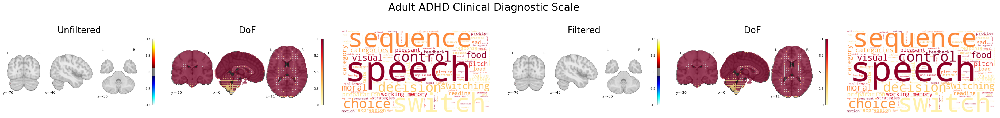

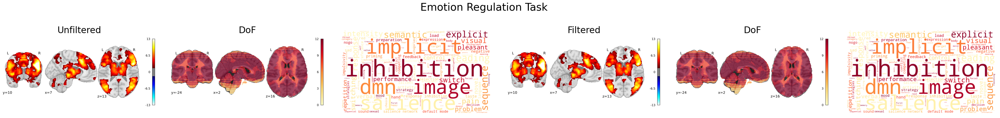

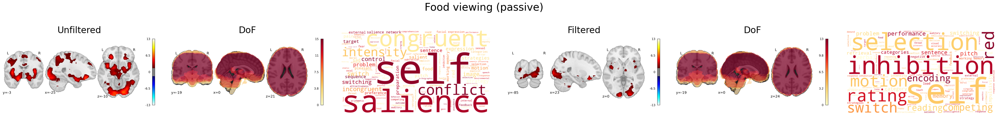

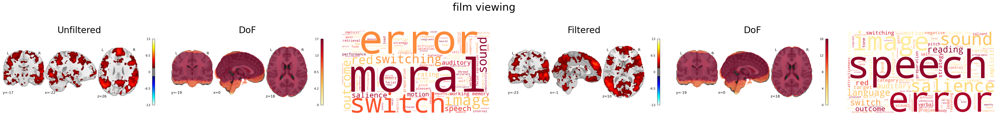

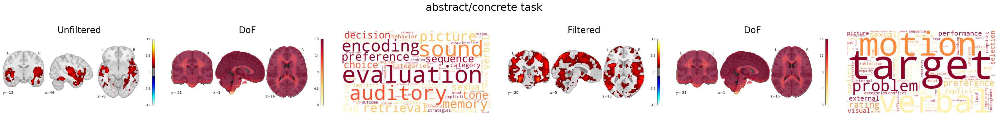

...

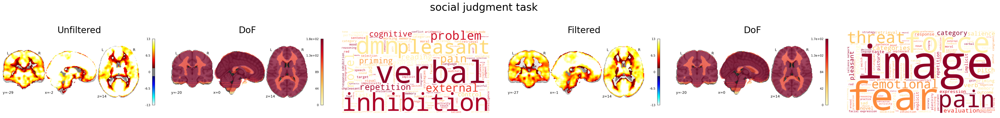

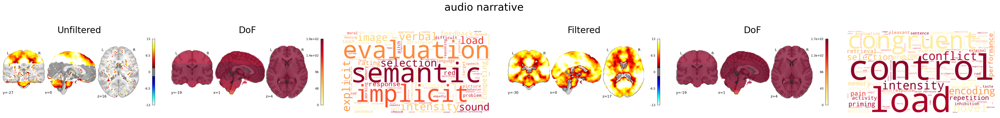

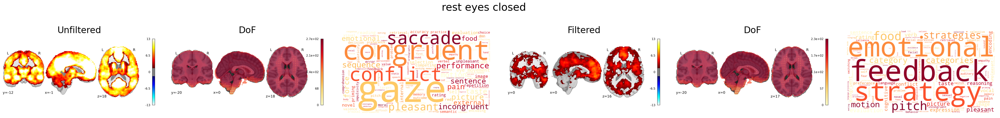

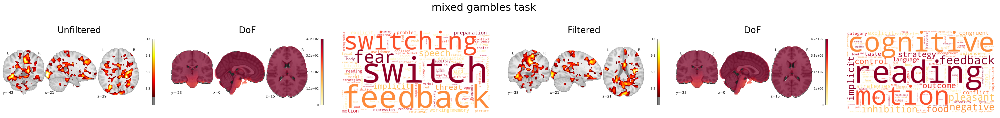

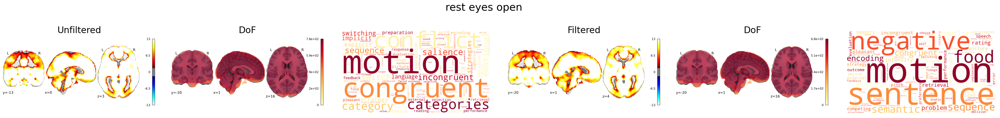

In [5]:
for task_name in task_names:
    output_file = op.join(fig_dec_dir, f"0_{task_name}.png")
    
    figure1 = plt.figure(figsize=(12*4, 2*4))
    gs = GridSpec(1, 6, figure=figure1)
    
    for type_i, data_type in enumerate(data_types):
        img_files = [ 
            op.join(fig_dec_dir, f"{task_name}_map-{data_type}.png"),
            op.join(fig_dec_dir, f"{task_name}_dof-{data_type}.png"),
            op.join(fig_dec_dir, f"{task_name}_wordcloud-{data_type}.png"),
        ]

        for column, fn in enumerate(img_files):
            img1 = mpimg.imread(fn)

            ax = figure1.add_subplot(gs[type_i*len(img_files) + column], aspect="equal")
            ax.imshow(img1)
            if column == 0:
                ax.set_title(data_tp_lb[type_i], fontsize=24)
            if column == 1:
                ax.set_title("DoF", fontsize=24)
            ax.set_axis_off()

    figure1.suptitle(cogat_dict[task_name], fontsize=28)
    figure1.subplots_adjust(wspace=0.1, top=1.2)
    figure1.savefig(output_file, bbox_inches="tight", dpi=300)
    plt.show()